# HW6 partial solution

This notebook provides code to do some of the tasks (particularly the important ones that carry on) in HW6.

In [1]:
# import block
import numpy as np
from astropy.io import fits
%matplotlib inline
from matplotlib import pyplot as plt
from astropy.visualization import hist
import ccdproc as ccdp
from matplotlib import rc
from datetime import datetime
from ccdproc import ImageFileCollection
import ccdproc as ccdp
from astropy.modeling.models import Polynomial1D,Chebyshev1D,Legendre1D,Hermite1D, Gaussian1D
from astropy.modeling import fitting
from astropy.stats import mad_std
from astropy.nddata import CCDData
from scipy import stats
from astropy import units as u
from photutils.aperture import CircularAperture,CircularAnnulus
from photutils.aperture import aperture_photometry
from astropy.stats import sigma_clipped_stats
from photutils.detection import DAOStarFinder
from astropy.table import Table
import sfdmap
import extinction
from astropy.coordinates import SkyCoord

In [2]:
# import convenience plotting functions downloaded from 
# here: https://github.com/mwcraig/ccd-reduction-and-photometry-guide
phot_tutorial_dir = '/Users/runnojc1/Dropbox/Research/teaching/F2021/ASTR8060/work/reductions/example/notebooks'
import sys
sys.path.insert(0,phot_tutorial_dir)
from convenience_functions import show_image

In [3]:
# plotting defaults
# Use custom style for larger fonts and figures
plt.style.use(phot_tutorial_dir+'/guide.mplstyle')

# Set some default parameters for the plots below
rc('font', size=20)
rc('axes', grid=True) 

In [4]:
data_dir = '/Users/runnojc1/Dropbox/Research/teaching/F2021/ASTR8060/Imaging/'            # raw data directory
reduced_dir = '/Users/runnojc1/Dropbox/Research/teaching/F2021/ASTR8060/Imaging_reduced/' # working directory

# 2. Linearity test

Find a star that saturates in the longest exposure, and just use the mean pixel counts from that frame. To get the highest possible counts, don't use the zero and flat-field subtracted frames (do use the trimmed ones, just because those are easier to work with). I used the region at [1705:1720,610:625].

I tried this using apertures, but too many steps take place and the counts don't get as high.

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


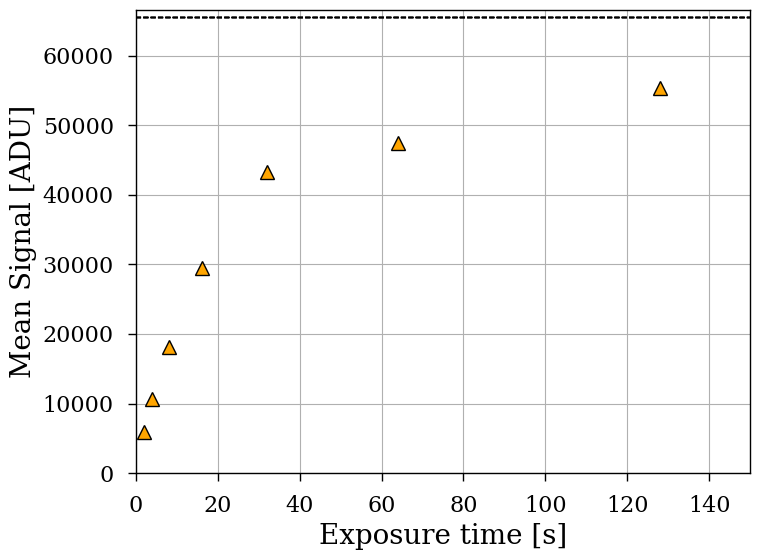

In [5]:
imgs       = ccdp.ImageFileCollection(reduced_dir,glob_include='*ot.fits')
sci_files  = imgs.files_filtered(imagetyp='science',include_path=True)

fig,ax= plt.subplots(1,1,figsize=(8,6))

for file in sci_files[0:7]:
    sci = CCDData.read(file,unit='adu')
    dat = sci.data
    hdr = sci.header
    
    exptime = hdr['EXPTIME']
    mn = dat[1705:1720,610:625]
    ax.plot(exptime,np.mean(mn),'orange',marker='^',markeredgecolor='k',markersize=10)
    ax.hlines(2**16,-500,500,'k',alpha=0.8,ls='--')
ax.set_xlabel('Exposure time [s]')   
ax.set_ylabel('Mean Signal [ADU]')   
ax.set_ylim([0,2**16+1000])
ax.set_xlim([0,150])
plt.legend()
plt.tight_layout()
plt.show()

# 3. Plot S/N versus aperture size

Calcualte the S/N versus aperture size. First, manually find the positions of three stars of varying brightness using imexam. Set up many circular apertures with $0.5 < r < 15$ pix and a background annulus $r_{in} = 15$ and $r_{out} = 20$. Choose the inner radius of the annulus to have at least 3*FWHM for the broadest stellar PSF, since this should include ~100\% of the stellar light. Just do the biggest one to avoid having to customize this for each star. 

Do aperture photometry in the many circular apertures and the background annulus. The mean background level must be correct for the area of the annulus. Then, calculate S/N using:

$$\frac{S}{N} = \frac{N_{S}}{\sqrt{N_{s}+A*N_{b}}}.$$

Here, $N_{S}=R_{S}\cdot t$ is the number of source photons, $N_{B} = R_{b}\cdot t$ is the number of background photons per area, and $A$ is the area of the aperture.

My findings are similar to Figure 5.7 on p. 118 of Howell. The ideal radius for $S/N$ is approximately the FWHM, and it is smaller for fainter sources. 

Recommendation: adopt an aperture of 4 pixels for aperture photometry.

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


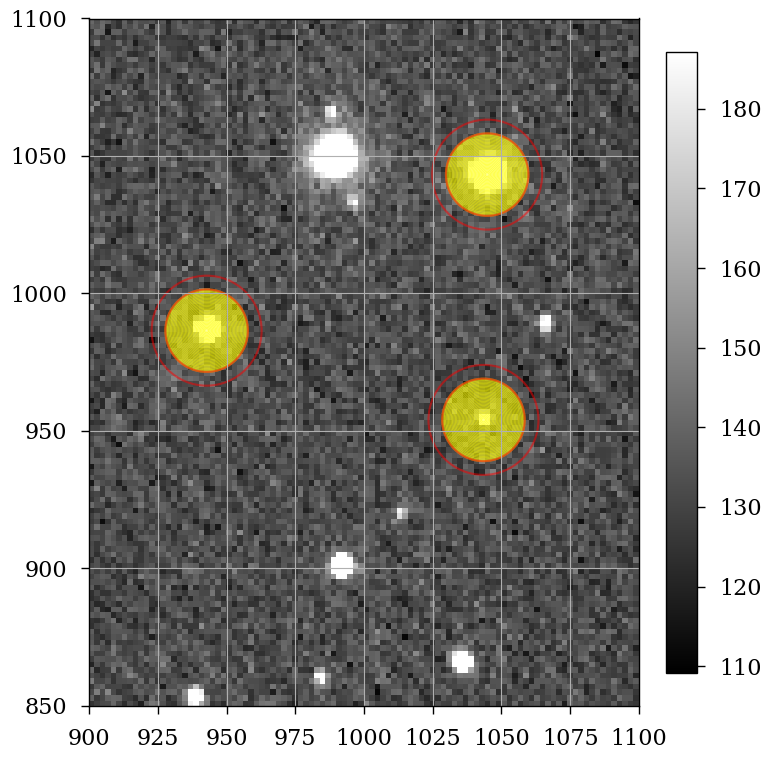

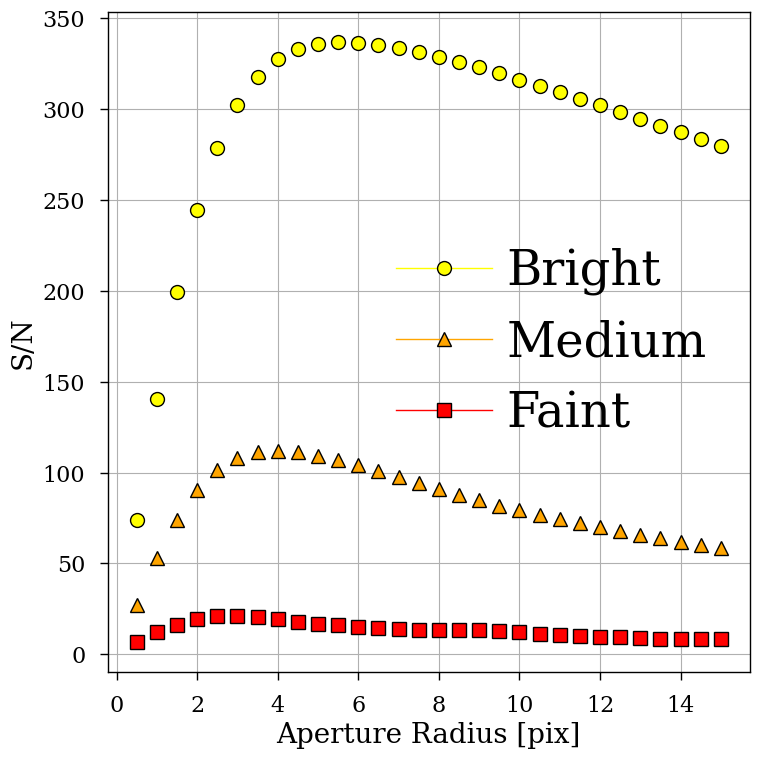

In [6]:
# the centers and fwhm for bright, medium, and faint stars
# these are determined manually using imexam for a085otzf.fits
positions  = [(1044.8029,1043.2159),(942.7512,986.4454),(1043.4568,953.9903)] # bright, medium, faint centers
fwhm       = [4.155, 3.878, 3.870]

# set up the data
sci        = CCDData.read(sci_files[11],unit='adu')
data       = sci.data

# calculate ap phot for many radii
radii      = np.arange(30)*0.5+0.5
apertures  = [CircularAperture(positions, r=r) for r in radii]
phot = aperture_photometry(data, apertures)
for col in phot.colnames:
    phot[col].info.format = '%.8g'              # for consistent table output
    
# calculate the mean background
# use an annulus that's >>3xFWHM for the broadest PSF
# since 3XFWHM should include ~100% of the stellar light
annulus_aperture = CircularAnnulus(positions, r_in=15., r_out=20.)
bg   = aperture_photometry(data,annulus_aperture)
for col in bg.colnames:
    bg[col].info.format = '%.8g'                # for consistent table output
msky = bg['aperture_sum']/annulus_aperture.area # get bg cts/pixel

# show the image with apertures
fig, ax = plt.subplots(1, 1, figsize=(8, 8))
show_image(data, cmap='gray', ax=ax, fig=fig)
for i in range(len(radii)): apertures[i].plot(color='yellow', lw=1.5, alpha=0.5) # apertures
annulus_aperture.plot(color='red', lw=1.5, alpha=0.5)                        # bg annulus
ax.set_xlim([900,1100])
ax.set_ylim([850,1100])
plt.tight_layout()
plt.show()

# loop over radii and calculate the S/N
fig, ax = plt.subplots(1, 1, figsize=(8, 8))
for i in range(len(radii)):
    Ns = phot.columns[i+3]-msky*apertures[i].area # get source counts without background, equivalent to Rs*t
    Nb = apertures[i].area*msky                   # get background counts, equivalent to Rb*t
    SN = Ns/np.sqrt(Ns+Nb)
    if i==0:
        ax.plot(radii[i],SN[0],'yellow',marker='o',markeredgecolor='k',markersize=10,label='Bright')
        ax.plot(radii[i],SN[1],'orange',marker='^',markeredgecolor='k',markersize=10,label='Medium')
        ax.plot(radii[i],SN[2],'red',marker='s',markeredgecolor='k',markersize=10,label='Faint')
    else:
        ax.plot(radii[i],SN[0],'yellow',marker='o',markeredgecolor='k',markersize=10)
        ax.plot(radii[i],SN[1],'orange',marker='^',markeredgecolor='k',markersize=10)
        ax.plot(radii[i],SN[2],'red',marker='s',markeredgecolor='k',markersize=10)

ax.set_xlabel('Aperture Radius [pix]')   
ax.set_ylabel('S/N')   
plt.legend()
plt.tight_layout()
plt.show()

# 3. Extract instrumental magnitudes

First, identify the standard stars.

In [7]:
%%html
<style>
  table {margin-left: 0 !important;}
</style>

From Landolt (1992): https://ui.adsabs.harvard.edu/abs/1992AJ....104..340L/abstract

| Star       | $\alpha$(2000)  | $\delta$(2000) | V     |
| -:         | :-:             | :-:            |:-:    |
| PG1633+099 | 16 35 24        | +09 47 50      |14.397 |
| PG1633+099A| 16 35 26        | +09 47 53      |15.256 |
| PG1633+099B| 16 35 34        | +09 46 22      |12.969 |
| PG1633+099C| 16 35 38        | +09 46 16      |13.229 |
| PG1633+099D| 16 35 40        | +09 46 43      |13.691 |

<img src="landolt_pg1633.png">

In the WIRO data, the frames are flipped relative to the Landolt finding charts.
<img src="wiro_a085_pg1633.png">

My process for making this was to select Edit>Region in DS9 to enter region mode. Then I put regions over each standard star in the Landolt field by hand. By double clicking a region, you can edit its center, radius, and label. I gave each a 20 pixel radius and set the coordinates by positioning the region manually. I copied the coordinates this produced for position of apertures in this notebook.

In [8]:
# create an astropy table with the standard star info
landolt = Table()
landolt['V']   = [14.397,15.256,12.969,13.229,13.691]
landolt['B-V'] = [-0.192,0.837,1.081,1.134,0.535] 
landolt['U-B'] = [-0.874,0.320,1.007,1.138,-0.025]
landolt['V-R'] = [-0.093,0.505,0.590,0.618,0.324]
landolt['R-I'] = [-0.116,0.511,0.502,0.523,0.327]
landolt['V-I'] = [-0.212,1.015,1.090,1.138,0.650]

landolt['B'] = landolt['B-V']+landolt['V']
landolt['U'] = landolt['U-B']+landolt['B']
landolt['R'] = landolt['V']-landolt['V-R']
landolt['I'] = landolt['V']-landolt['V-I']

In [9]:
landolt

V,B-V,U-B,V-R,R-I,V-I,B,U,R,I
float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
14.397,-0.192,-0.874,-0.093,-0.116,-0.212,14.205,13.331,14.49,14.609
15.256,0.837,0.32,0.505,0.511,1.015,16.093,16.413,14.751,14.241
12.969,1.081,1.007,0.59,0.502,1.09,14.049999999999999,15.056999999999999,12.379,11.879
13.229,1.134,1.138,0.618,0.523,1.138,14.363,15.501,12.610999999999999,12.091
13.691,0.535,-0.025,0.324,0.327,0.65,14.226,14.201,13.367,13.041


Now, calculate instrumental magnitudes for all the PG1633+099 frames.


In [10]:
def get_phot(file,approx_pos,title):
    '''
    This function takes an input file, list of positions for stars to find, and plot title.
    
    It executes the following steps:
    1. Read in the data.
    2. Find all sources in the image. It assumes the FWHM is approximately 4 pix and finds everything greater than 10 sigma.
    3. It collects the info for the sources given in the input position list, matching within 10 pixel positions.
    4. It puts r=10pix apertures on each of these stars, as well as r_in=15, r_out=20 background annuli.
    5. It calculates background-subtracted instrumental magnitudes.
    6. It plots the image and apertures for visual inspection.
    7. It returns a table of photometry.
    '''
    fwhm       = 4.0
    source_snr = 10

    sci        = CCDData.read(file,unit='adu')
    data       = sci.data
    hdr        = sci.header
    
    mean, median, std = sigma_clipped_stats(data, sigma=3.0)    
    daofind = DAOStarFinder(fwhm=fwhm, threshold=source_snr*std)    
    sources = daofind(data)
    
    positions = np.zeros_like(approx_pos)
    for position,i in zip(approx_pos,range(np.shape(approx_pos)[0])):
        match = np.where((abs(sources['xcentroid']-position[0])<10) & (abs(sources['ycentroid']-position[1])<10))[0][0]
        positions[i] = (sources['xcentroid'][match],sources['ycentroid'][match])
          
    # photometry
    # biggest FWHM is 4.2 pix
    aperture  = CircularAperture(positions, r=4)
    phot = aperture_photometry(data, aperture)
    for col in phot.colnames:
        phot[col].info.format = '%.8g'              # for consistent table output
        
    # calculate the mean background
    # note that for PG1633+099, this will include two little stars :(
    annulus_aperture = CircularAnnulus(positions, r_in=15., r_out=20.)
    bg   = aperture_photometry(data,annulus_aperture)
    for col in bg.colnames:
        bg[col].info.format = '%.8g'                # for consistent table output
    msky = bg['aperture_sum']/annulus_aperture.area # get bg cts/pixel
    
    phot['inst_mag'] = -2.5 * np.log10(phot.columns['aperture_sum']-msky*aperture.area)
      
    # show the image with apertures
    fig, ax = plt.subplots(1, 1, figsize=(8, 8))
    show_image(data, cmap='gray', ax=ax, fig=fig)
    aperture.plot(color='green', lw=1.5, alpha=0.5) # apertures
    annulus_aperture.plot(color='red', lw=1.5, alpha=0.5)                        # bg annulus
    ax.set_xlim([800,1500])
    ax.set_ylim([800,1500])
    plt.title(title)
    plt.tight_layout()
    plt.show()
    
    return phot

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


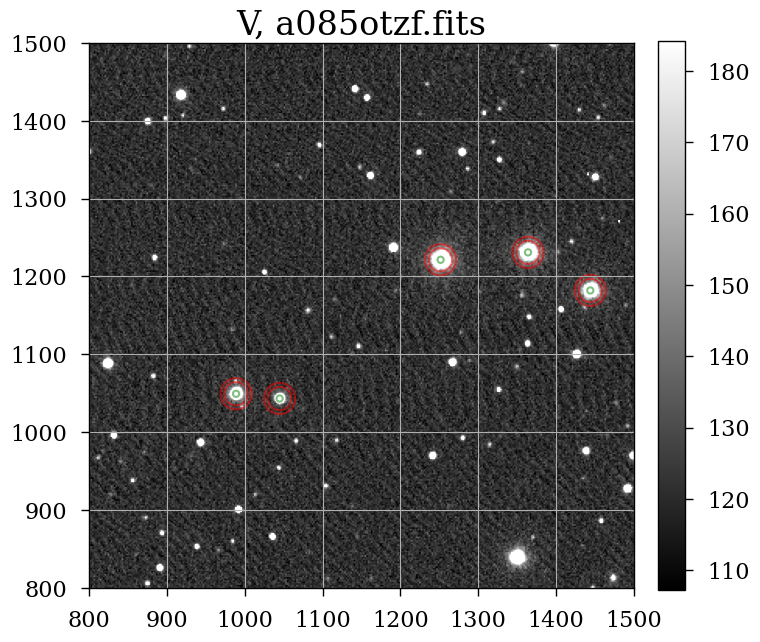

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


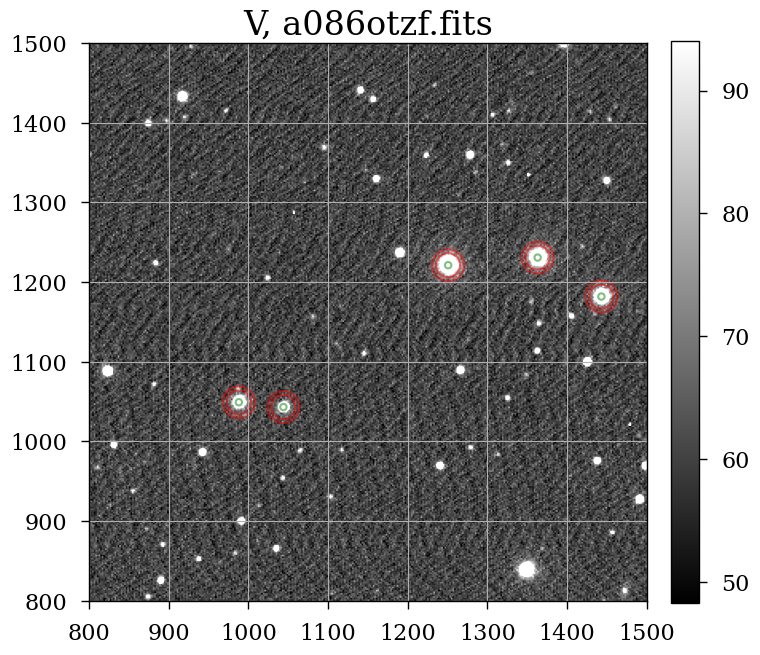

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


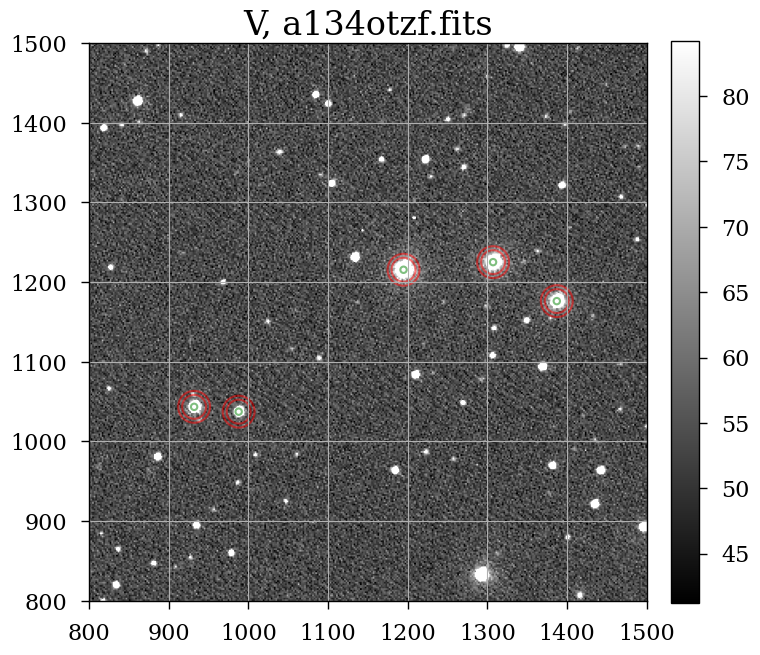

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


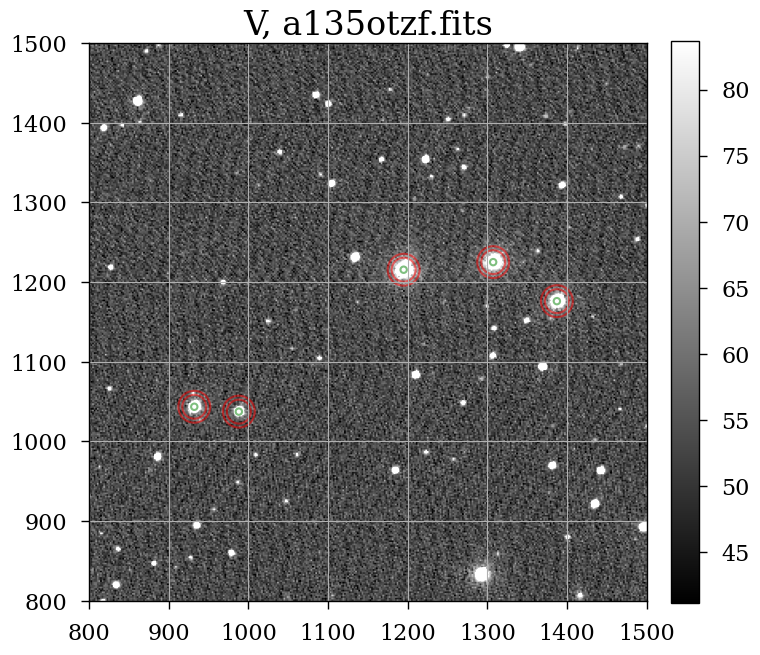

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


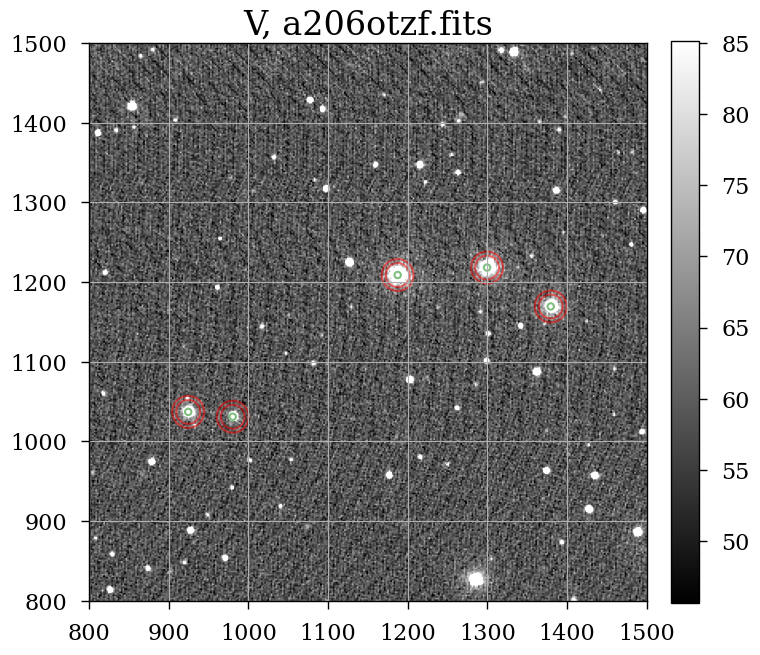

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


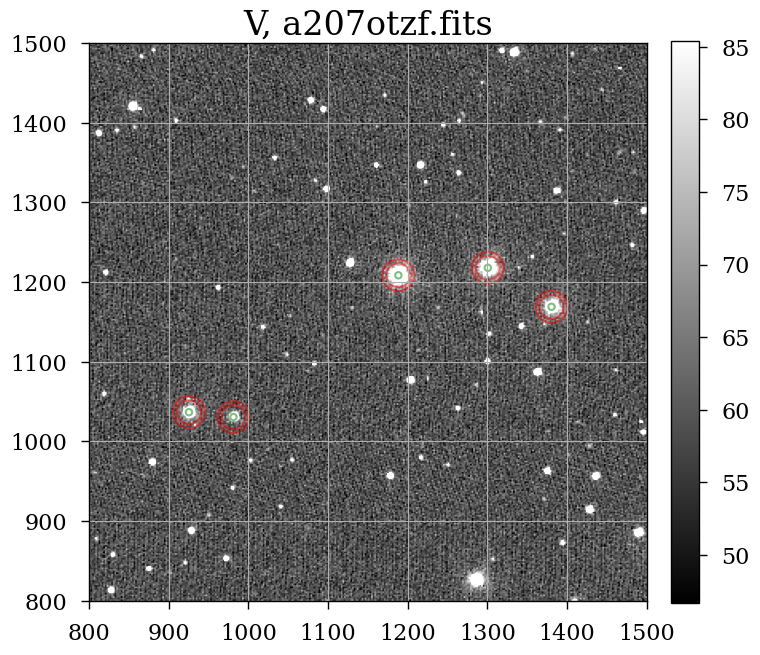

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


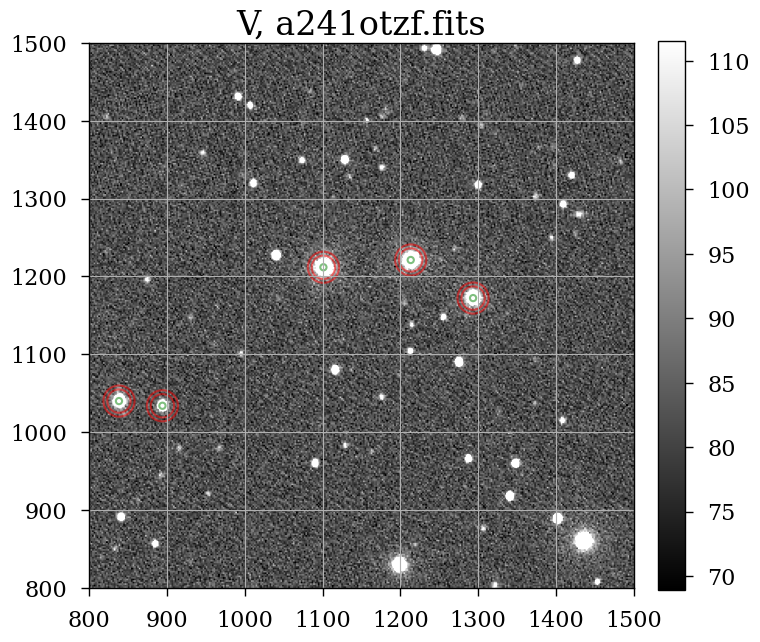

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


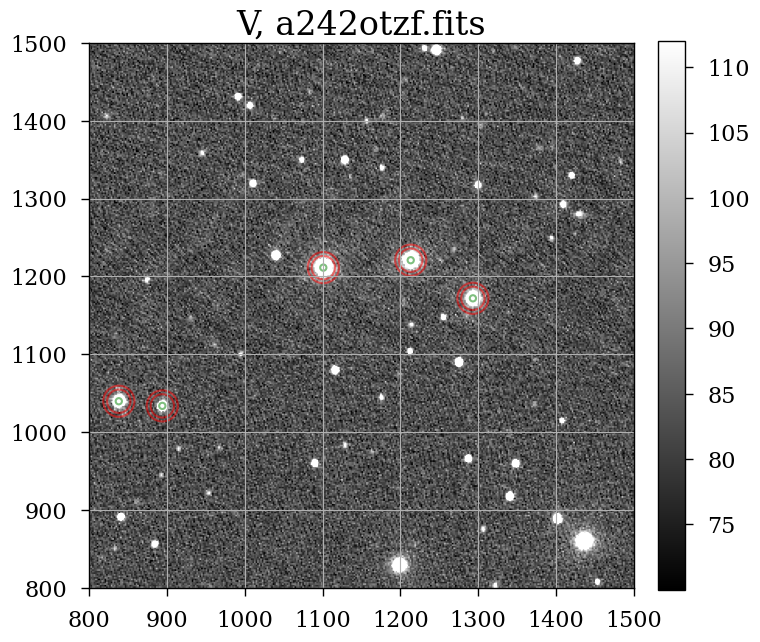

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


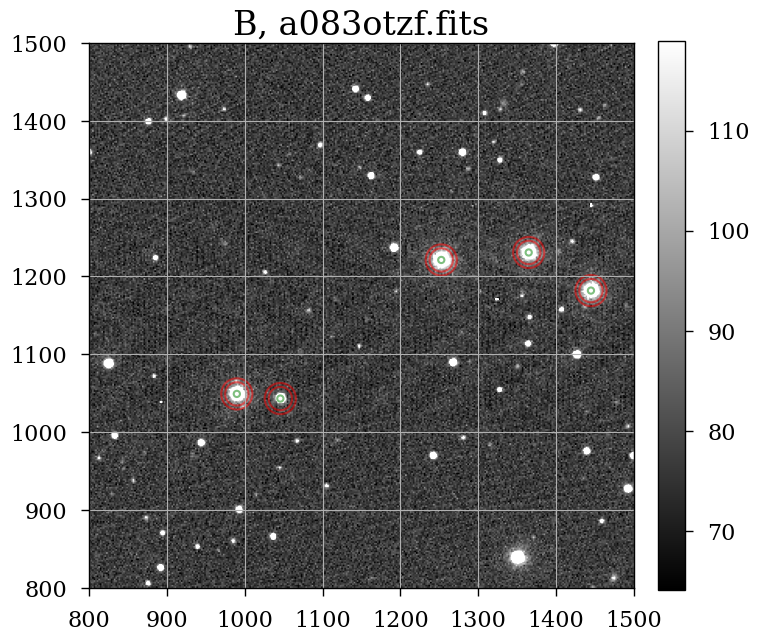

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


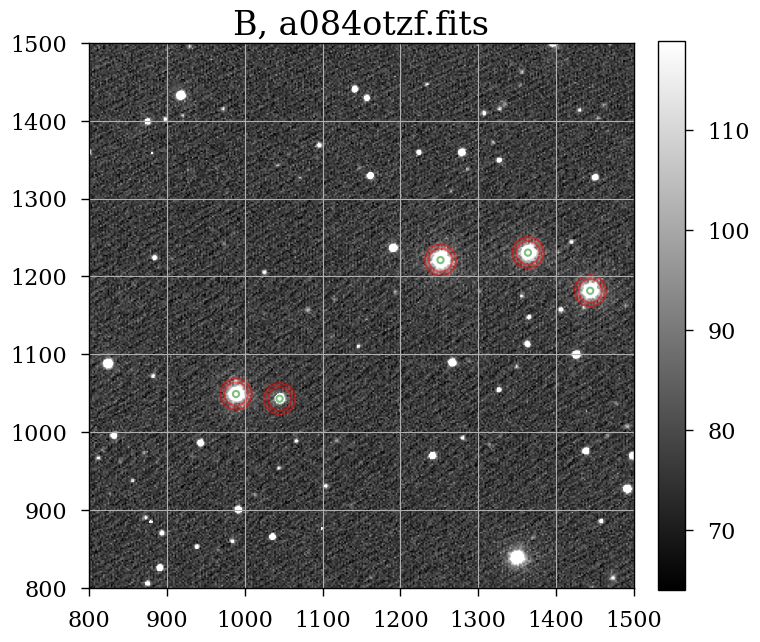

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


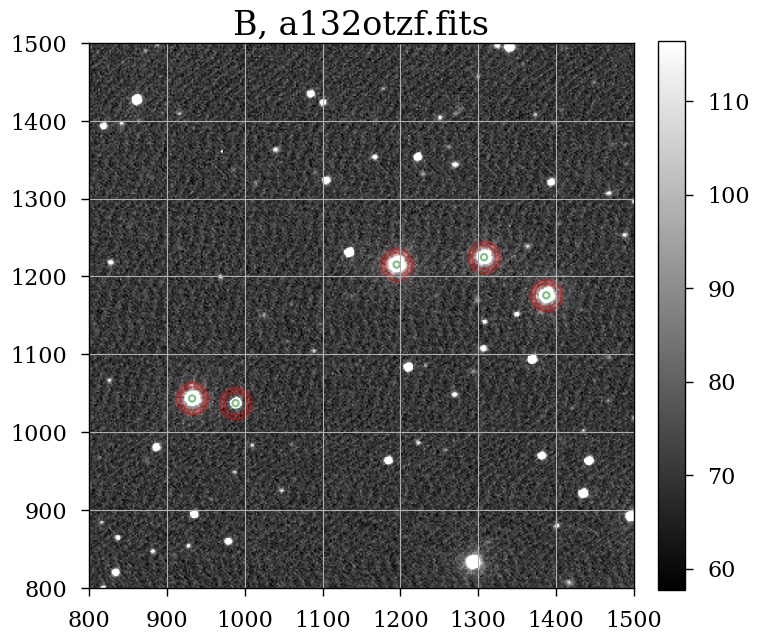

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


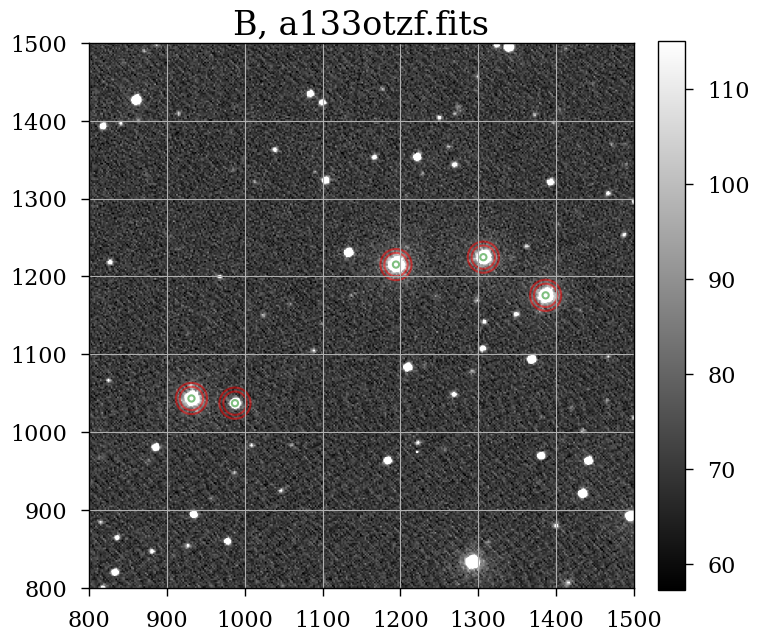

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


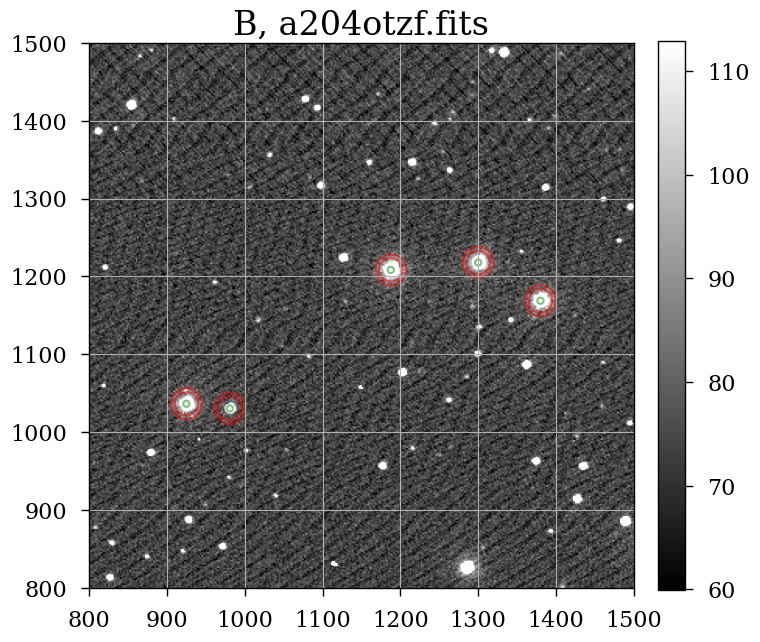

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


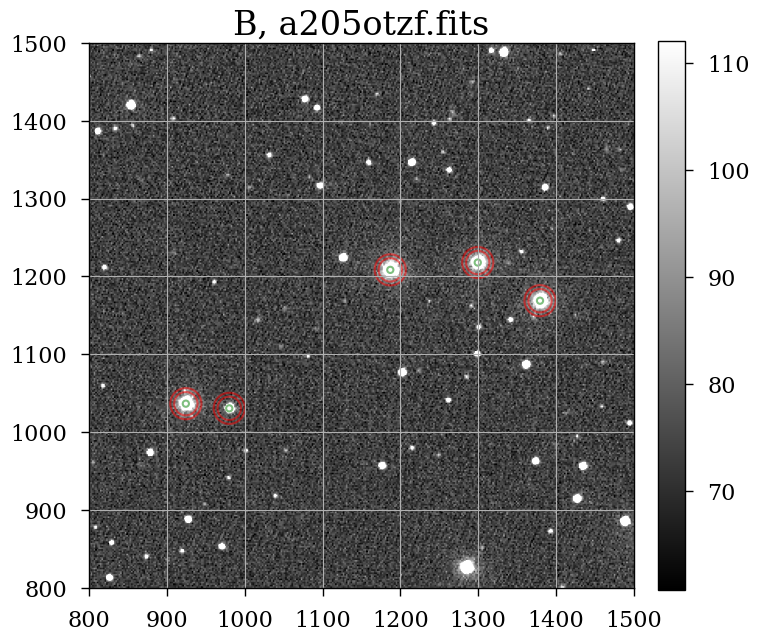

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


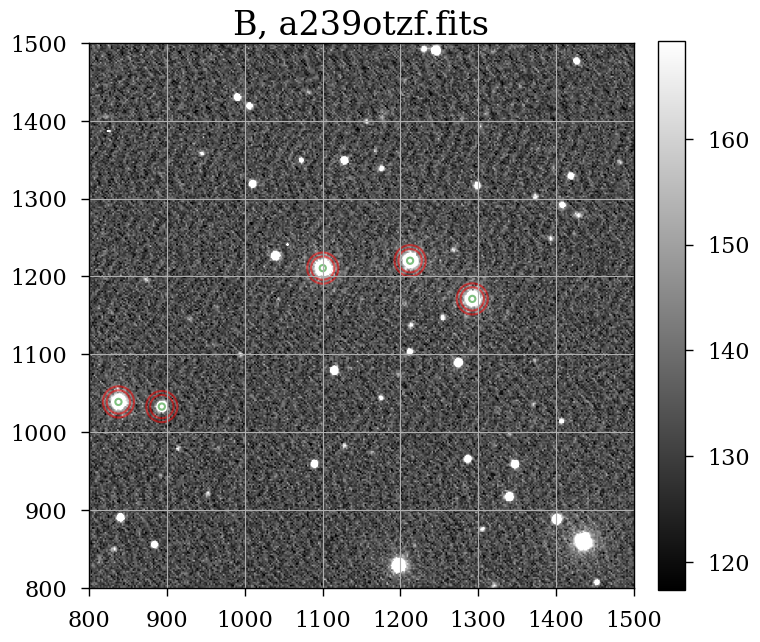

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


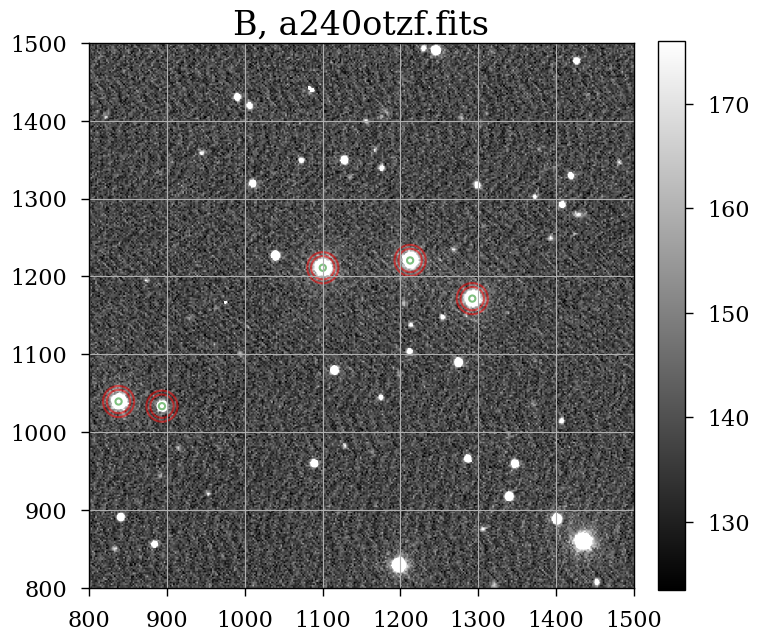

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


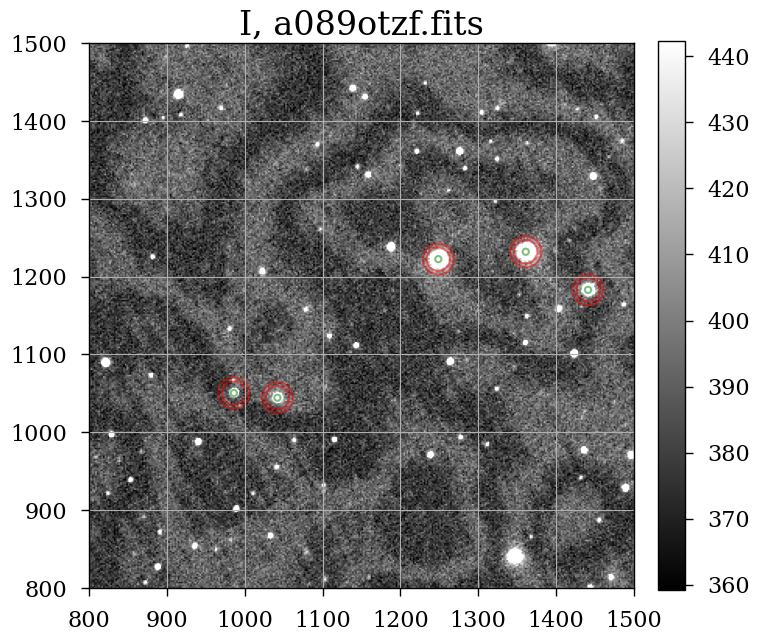

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


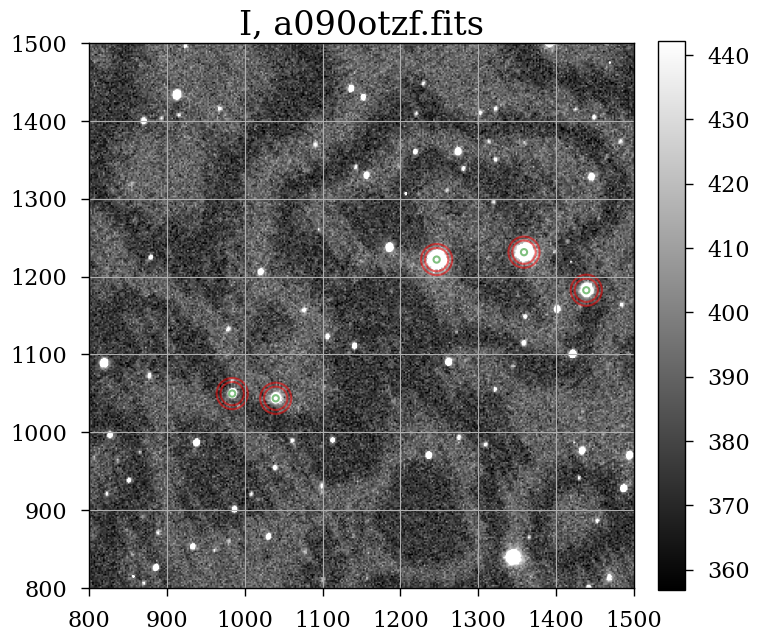

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


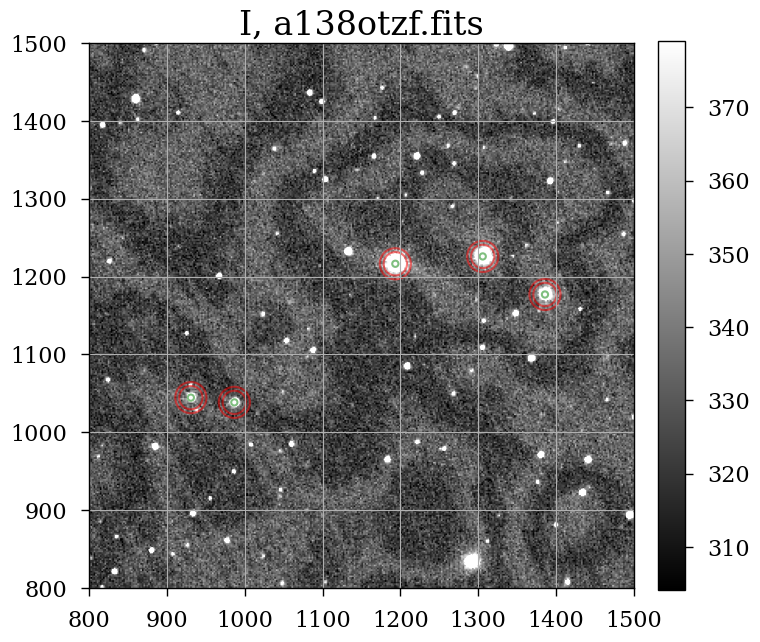

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


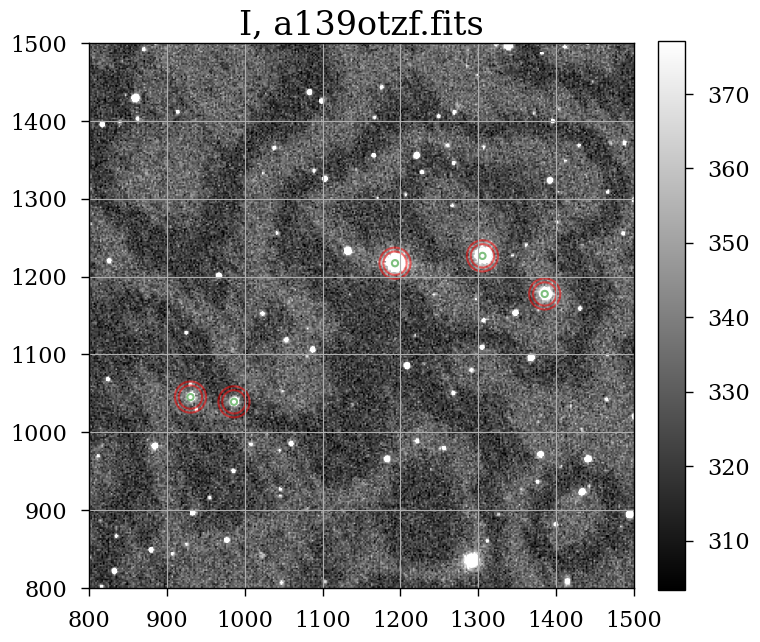

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


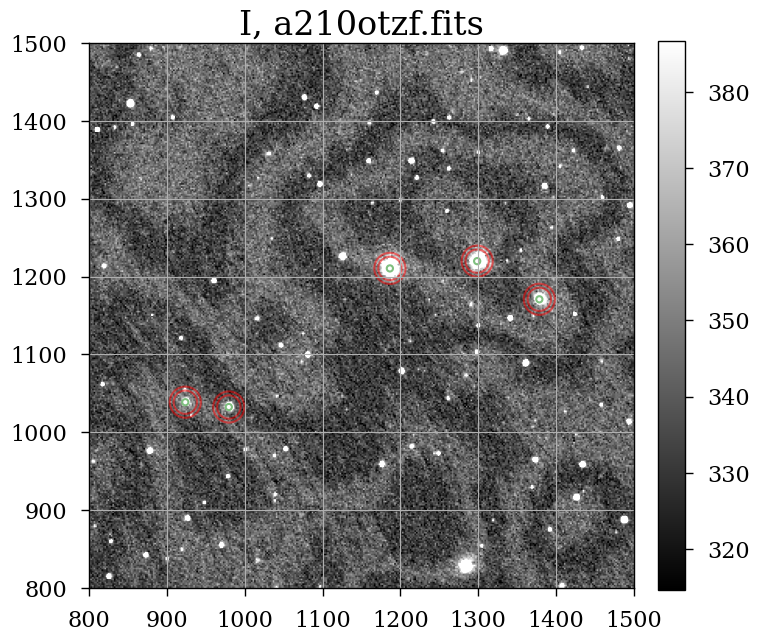

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


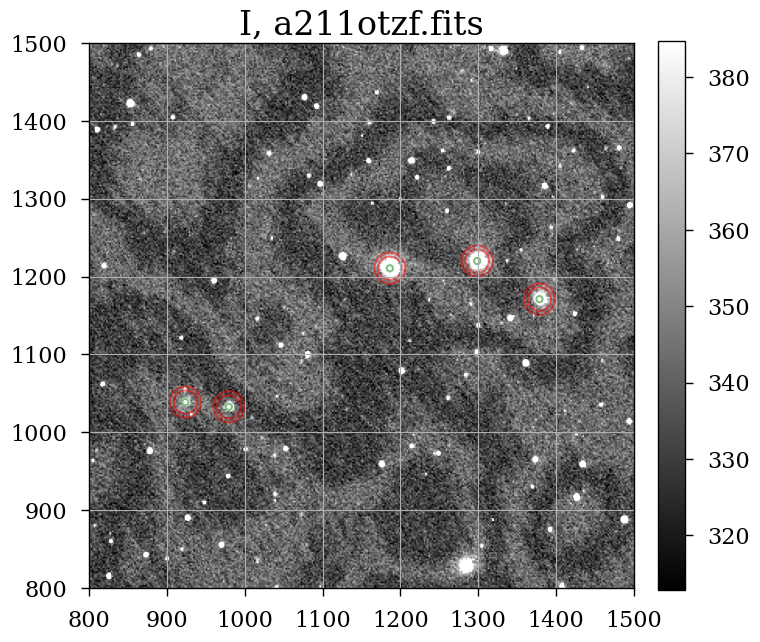

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


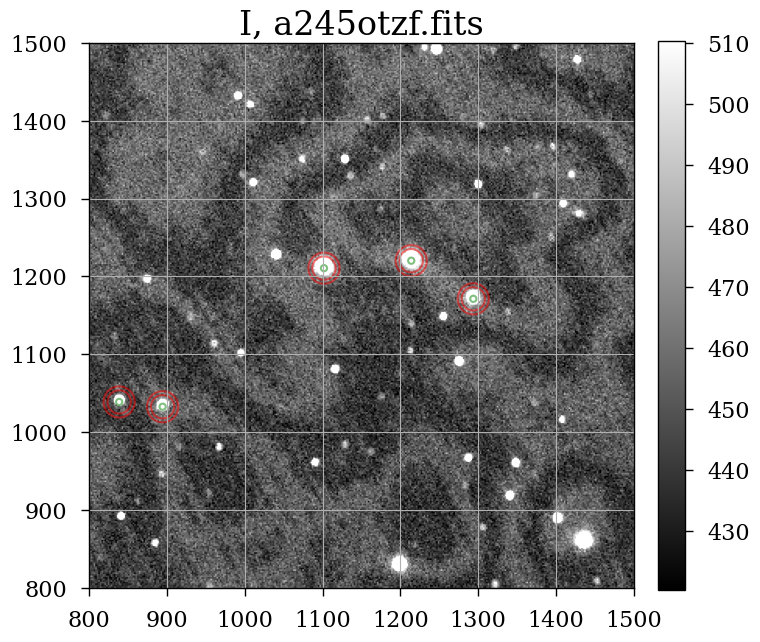

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


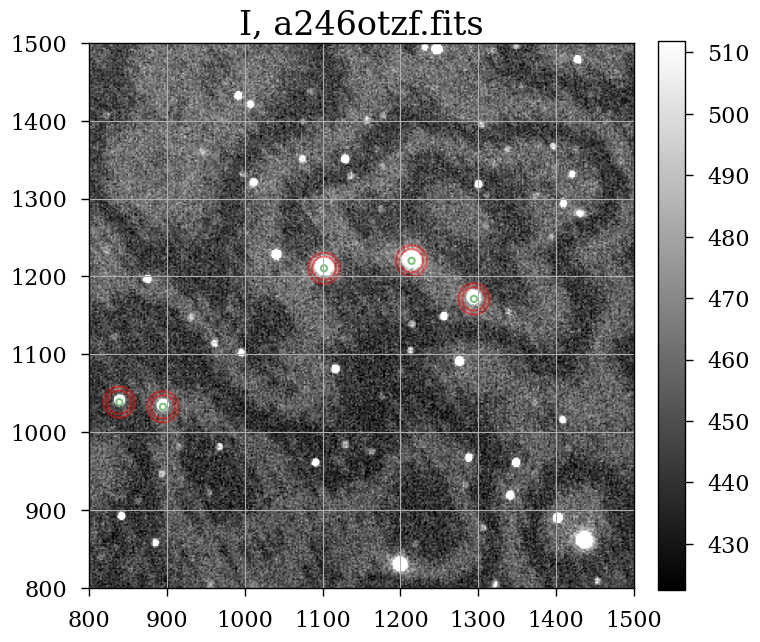

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


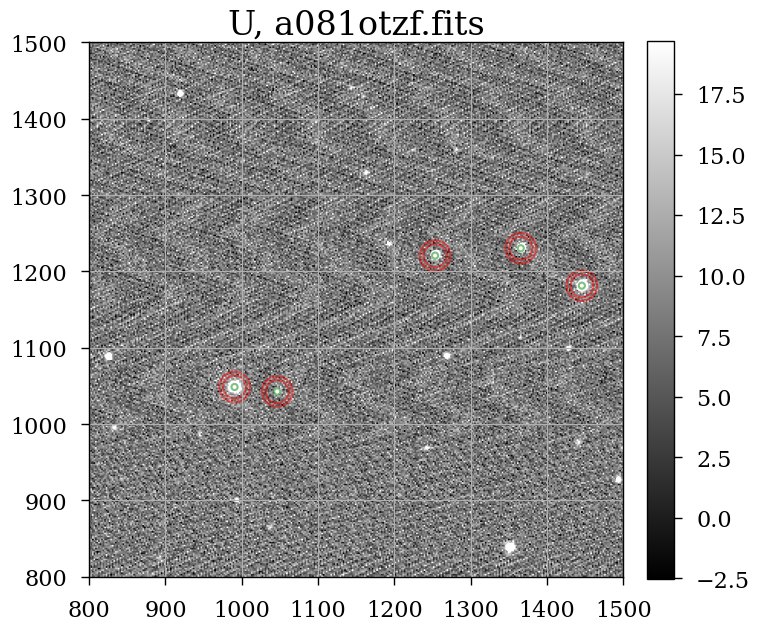

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


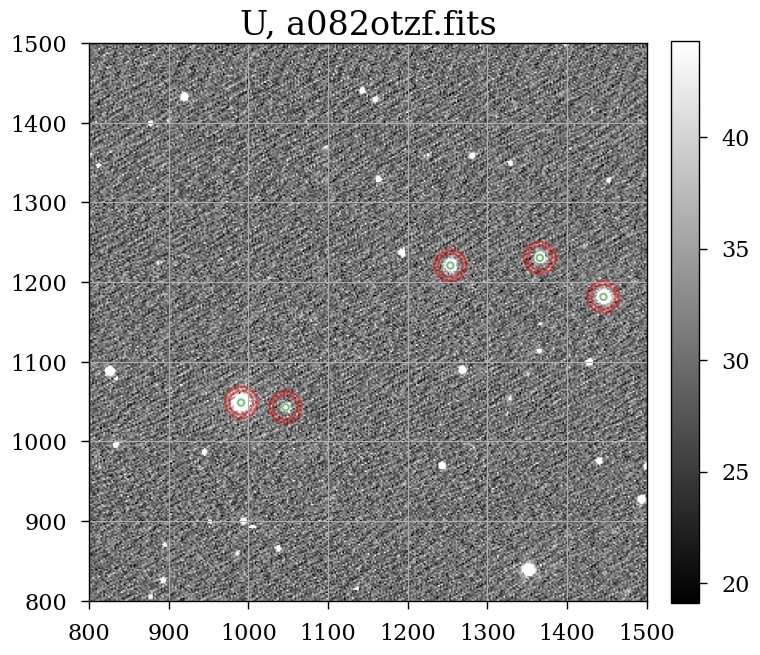

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


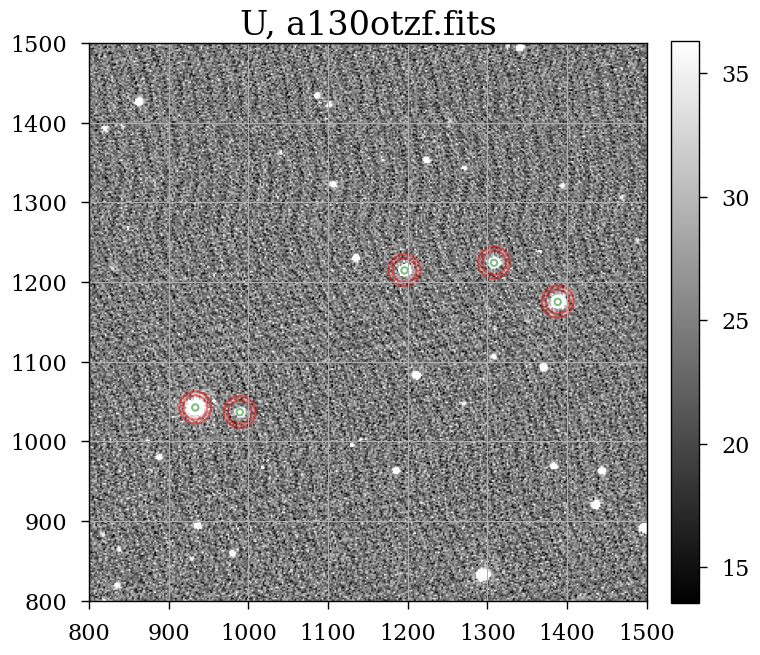

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


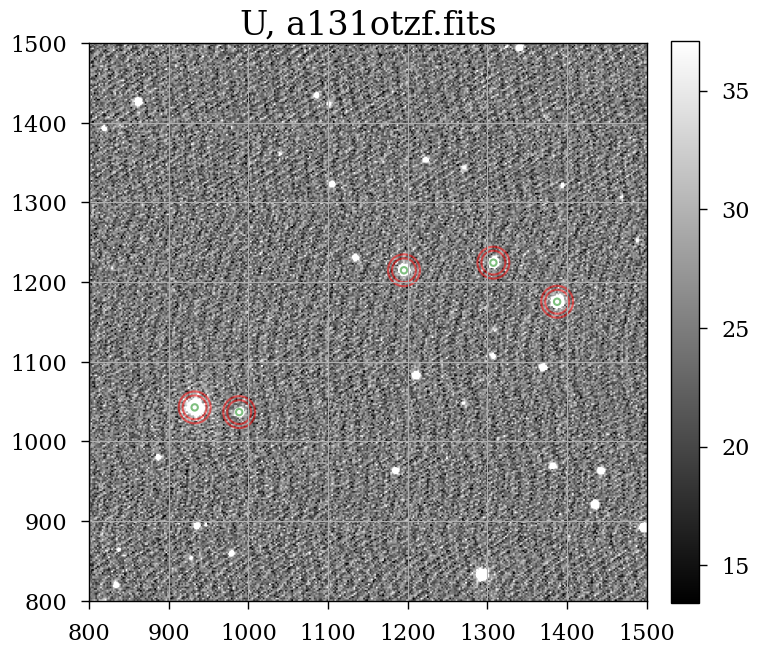

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


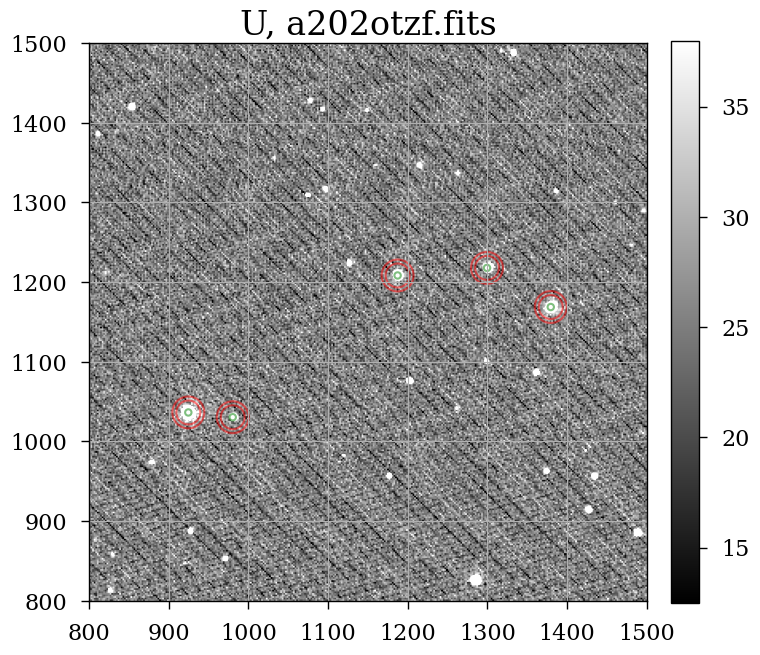

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


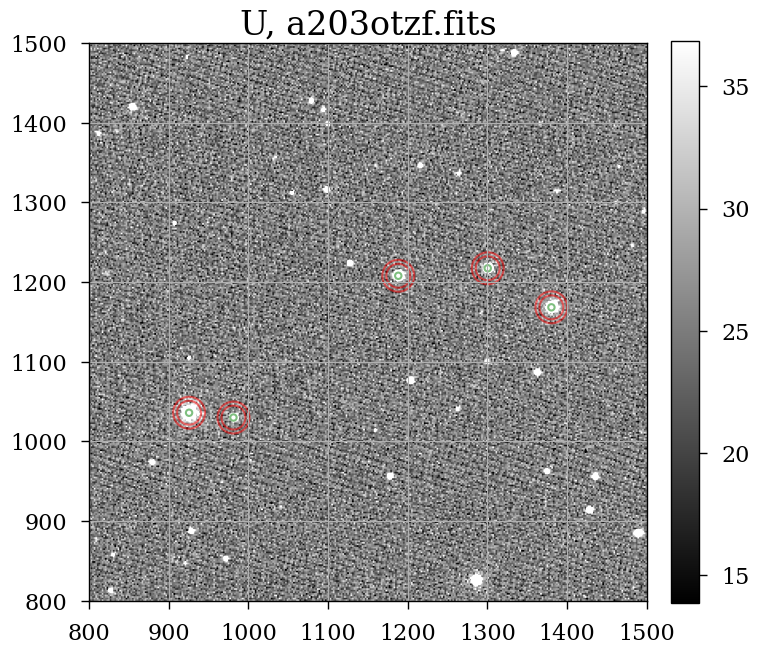

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


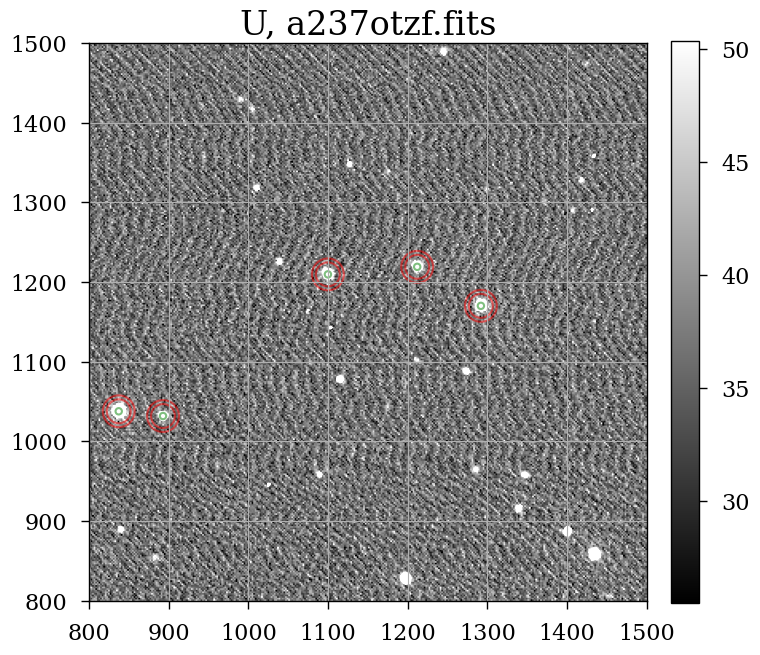

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


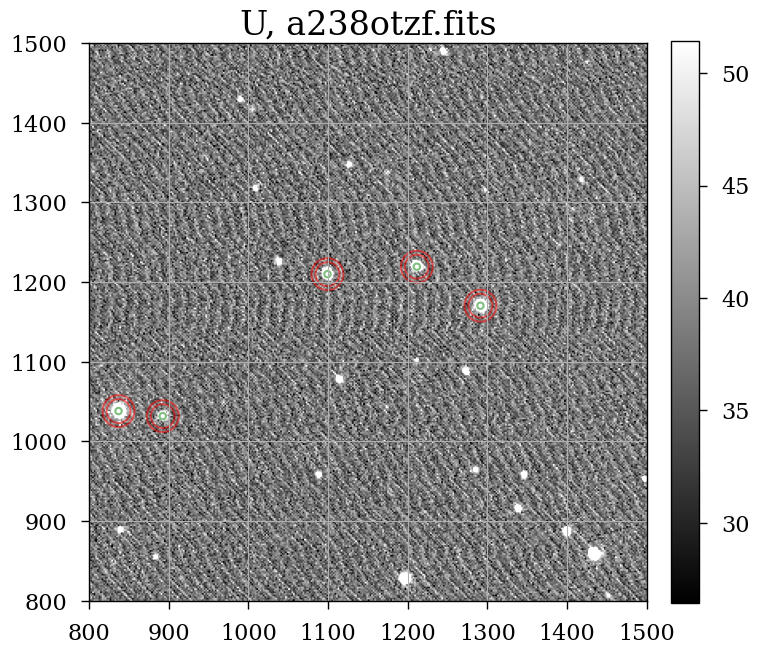

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


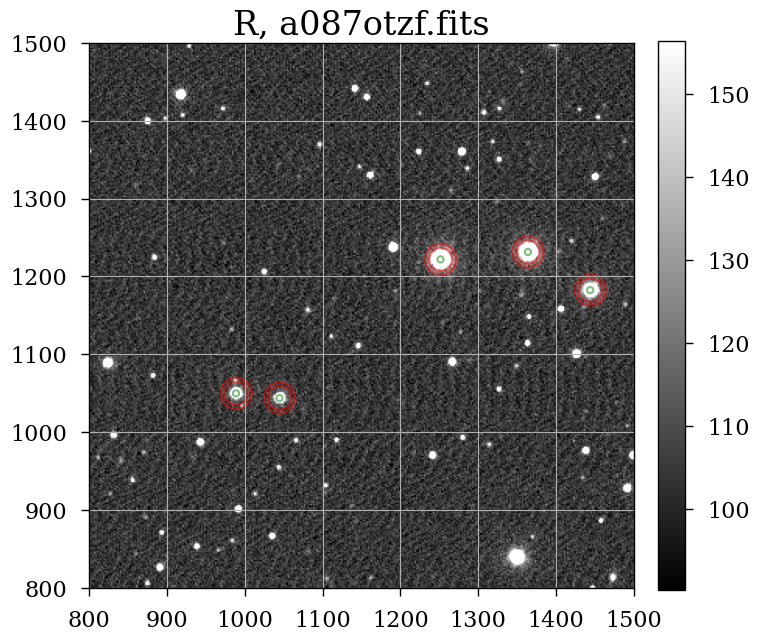

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


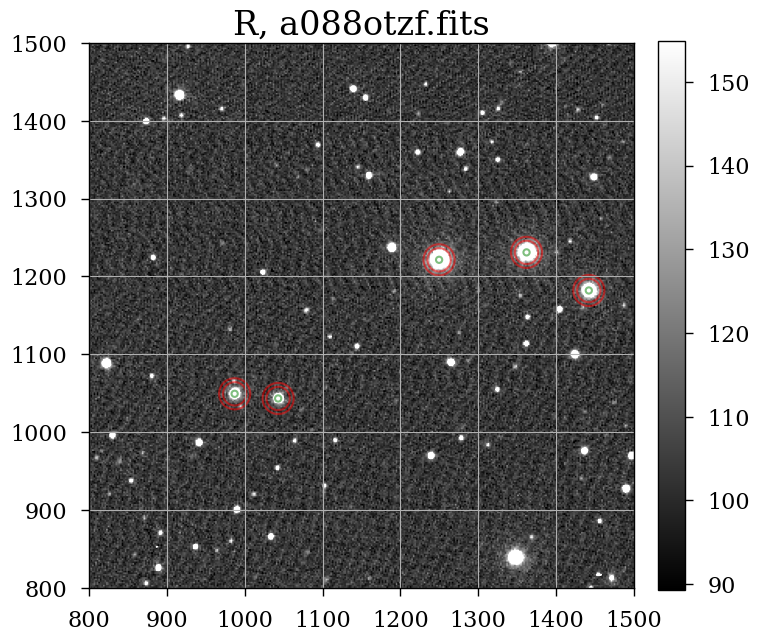

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


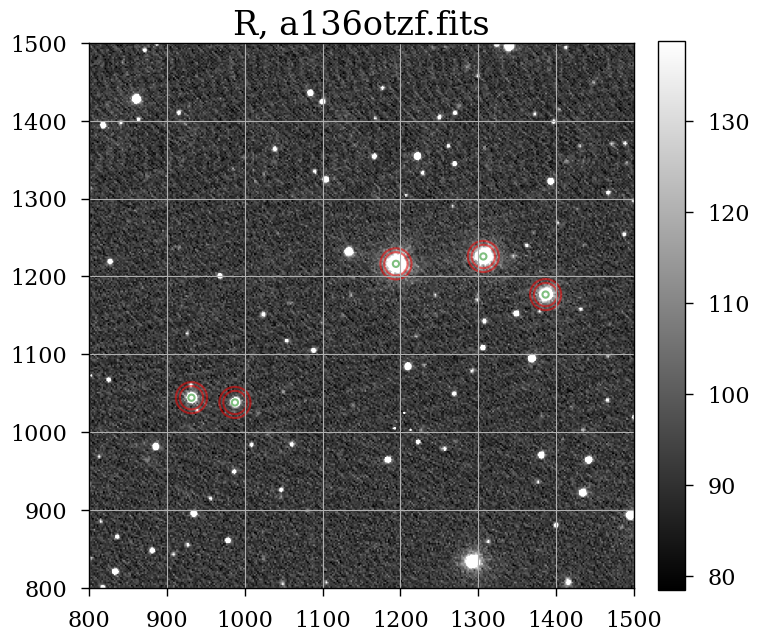

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


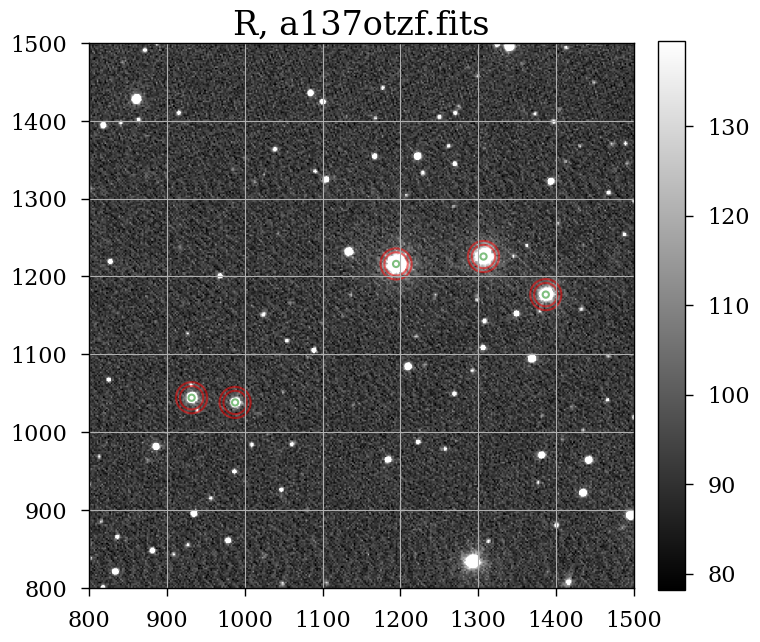

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


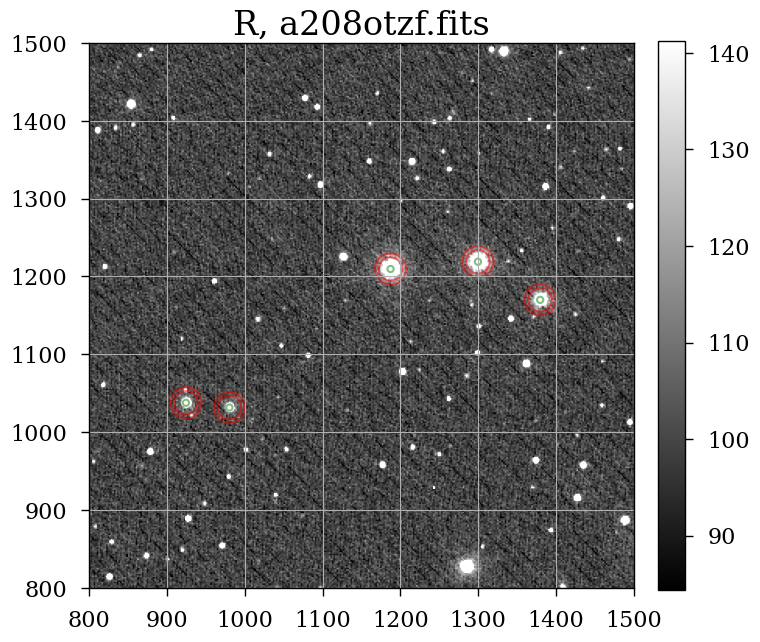

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


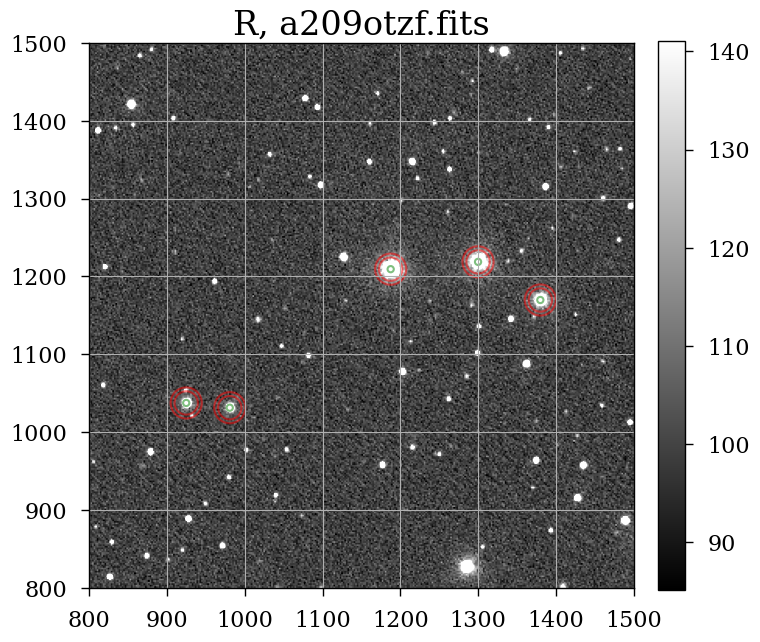

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


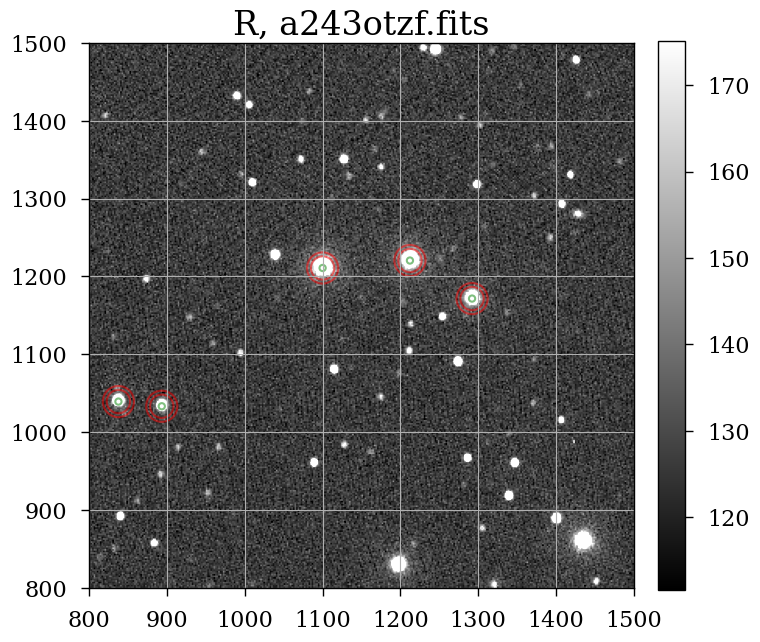

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


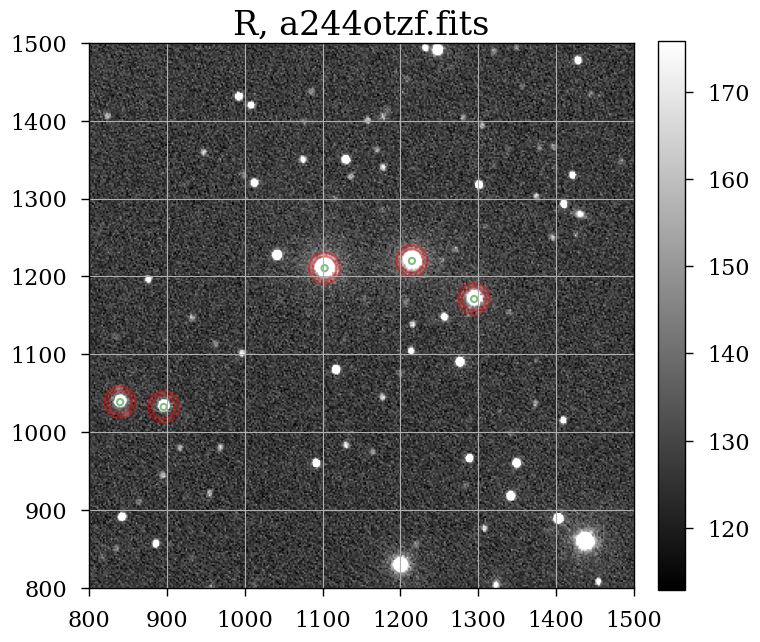

In [19]:
# grab the science frames
# skip Ha, because it's only observed at one airmass
imgs       = ccdp.ImageFileCollection(reduced_dir,glob_include='*otzf.fits')
sci_files  = imgs.files_filtered(imagetyp='science',object='pg1633',include_path=True)
sci = ((imgs.summary['imagetyp'] == 'science') & (imgs.summary['filter'] != 'Ha'))
sci_filters = set(imgs.summary['filter'][sci])

# these are found from imxam for the V filter, but work well enough to find positions in the other filters
# it is important that the positions go in order 1-A-B-C-D to match the standard mags I stored in the Landolt table
approx_pos = [[(988.8683,1049.2803),(1044.8029,1043.2159),(1251.6695,1221.4295),(1363.9839,1230.9691),(1444.0144,1182.0372)],\
[(987.9844,1049.2036),(1043.8968,1043.1361),(1250.6889,1221.1958),(1363.0112,1230.7516),(1443.0305,1181.8385)],\
[(931.8118,1043.4529),(987.6939,1037.3564),(1194.6650,1215.5002),(1307.0202,1225.0282),(1386.9956,1176.1044)],\
[(932.0204,1043.5176),(987.9188,1037.3954),(1194.7984,1215.5333),(1307.1397,1225.0323),(1387.0961,1176.0627)],\
[(924.4201,1037.0850),(980.2808,1030.9915),(1187.3280,1208.8491),(1299.5213,1218.2871),(1379.4235,1169.3869)],\
[(925.3480,1036.7100),(981.2349,1030.6284),(1188.1673,1208.4725),(1300.4663,1217.9357),(1380.4332,1168.9797)],\
[(838.3982,1039.8684),(894.1732,1033.8111),(1101.0422,1211.7489),(1213.2663,1221.1237),(1293.3098,1172.1284)],\
[(838.1403,1039.7337),(893.9993,1033.6562),(1100.9368,1211.3933),(1213.1794,1220.8576),(1293.1324,1171.9191)]]

# set up an astropy Table for standard transformations
standards = Table()
standards['filter'] = [filtr for filtr in sci_filters]
standards['k'] = np.zeros(len(sci_filters))

# loop over the filters
for filtr,ii in zip(sci_filters,range(len(sci_filters))):
    # get files in this filter
    sci_infilter = imgs.files_filtered(imagetyp='science', object='pg1633',filter=filtr,include_path=True)
    
    if filtr=='V': # skip the linearity test
        sci_infilter = sci_infilter[7:]
    
    # do aperture photometry
    phot = [get_phot(file,approx_pos[i],filtr+', '+file.split('/')[-1]) for file,i in zip(sci_infilter,range(len(sci_infilter)))]